In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.append("../")
import warnings
warnings.filterwarnings("ignore")

In [17]:
import pickle
import glob
from tqdm.notebook import trange, tqdm
import json
import re
import pandas as pd
import numpy as np
from collections import defaultdict

from utills import chunker, cartesian_product, get_num_chunks, c_at_1, f_05_u_score
from train_utils import generate_doc_pairs_no_chunking, get_random_author_excluding, generate_doc_pairs, fit_transformers, vectorize


from sklearn.linear_model import SGDClassifier
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_curve, auc, precision_score, recall_score

from sklearn.utils.fixes import loguniform
from sklearn.model_selection import RandomizedSearchCV

In [22]:
from matplotlib import rcParams
import matplotlib.pyplot as plt
import matplotlib.style as style

from plotly.offline import init_notebook_mode
import plotly.offline as py
import plotly.graph_objs as go
init_notebook_mode(connected=True)

In [4]:
# BASE_PATH = '../data/reddit_2/'
COMPUTED_DATA_PATH = '../temp_data/reddit/preprocessed/'
RESULTS_PATH = '../temp_data/reddit/combined_results/'
chunk_sz=20

In [5]:
# with open(COMPUTED_DATA_PATH + 'model_no_chunking_capped.p', 'rb') as f:
#     (clf_nc, transformer_nc, scaler_nc, secondary_scaler_nc, _) = pickle.load(f)
    
# with open(COMPUTED_DATA_PATH + 'model_no_chunking.p', 'rb') as f:
#     (clf_nc, transformer_nc, scaler_nc, secondary_scaler_nc, _) = pickle.load(f)
    
with open('../temp_data/reddit/unchunked/model.p', 'rb') as f:
    (clf_nc, transformer_nc, scaler_nc, secondary_scaler_nc, _) = pickle.load(f)

In [6]:
# with open('../temp_data/reddit/multidoc_20/model_20.p', 'rb') as f:
#     (clf, transformer, scaler, secondary_scaler, _) = pickle.load(f)

# with open('../temp_data/reddit/multidoc_40/model_40.p', 'rb') as f:
#     (clf, transformer, scaler, secondary_scaler, _) = pickle.load(f)

with open('../temp_data/reddit/multidoc_10/model_10.p', 'rb') as f:
    (clf, transformer, scaler, secondary_scaler, _) = pickle.load(f)
    
# with open(COMPUTED_DATA_PATH + 'model_' + str(chunk_sz) + '_limitted_data_capped.p', 'rb') as f:
#     (clf, transformer, scaler, secondary_scaler, _) = pickle.load(f)

In [7]:
# with open(COMPUTED_DATA_PATH + 'training_meta_data_no_chunking_capped.p', 'rb') as f:
#     (_, author_to_doc_idx_nc,  _, author_subreddit_nc, _, x_shape_nc) = pickle.load(f)
    
# with open(COMPUTED_DATA_PATH + 'training_meta_data_' + str(chunk_sz) + '_capped.p', 'rb') as f:
#     (_, author_bounds_c, _, author_subreddit_c, _, x_shape_c) = pickle.load(f)


# with open(COMPUTED_DATA_PATH + 'training_meta_data_no_chunking.p', 'rb') as f:
#     (_, author_to_doc_idx_nc,  _, author_subreddit_nc, _, x_shape_nc) = pickle.load(f)
    
# with open(COMPUTED_DATA_PATH + 'training_meta_data_' + str(chunk_sz) + '.p', 'rb') as f:
#     (_, author_bounds_c, _, author_subreddit_c, _, x_shape_c) = pickle.load(f)
    
    
with open('../temp_data/reddit/unchunked/experiment_data.p', 'rb') as f:
    (_, author_to_doc_idx_nc,  _, author_subreddit_nc, _, x_shape_nc, _, _, _, _) = pickle.load(f)

# with open('../temp_data/reddit/multidoc_20/experiment_data20.p', 'rb') as f:
#     (_, author_bounds_c, _, author_subreddit_c, _, x_shape_c, _, _, _, _) = pickle.load(f)
    
# with open('../temp_data/reddit/multidoc_40/experiment_data40.p', 'rb') as f:
#     (_, author_bounds_c, _, author_subreddit_c, _, x_shape_c, _, _, _, _) = pickle.load(f)

with open('../temp_data/reddit/multidoc_10/experiment_data10.p', 'rb') as f:
    (_, author_bounds_c, _, author_subreddit_c, _, x_shape_c, _, _, _, _) = pickle.load(f)

In [8]:
# XX_nc = np.memmap(COMPUTED_DATA_PATH + 'XX_test_no_chunking_capped.npy', dtype='float32', mode='r', shape=x_shape_nc)
# XX_c = np.memmap(COMPUTED_DATA_PATH + 'XX_test_' + str(chunk_sz) + '_capped.npy', dtype='float32', mode='r', shape=x_shape_c)


XX_nc = np.memmap('../temp_data/reddit/unchunked/XX_test.npy', dtype='float32', mode='r', shape=x_shape_nc)
# XX_c = np.memmap('../temp_data/reddit/multidoc_20/XX_test_20.npy', dtype='float32', mode='r', shape=x_shape_c)
# XX_c = np.memmap('../temp_data/reddit/multidoc_40/XX_test_40.npy', dtype='float32', mode='r', shape=x_shape_c)
XX_c = np.memmap('../temp_data/reddit/multidoc_10/XX_test_10.npy', dtype='float32', mode='r', shape=x_shape_c)

In [30]:
# author_comment_lengths = {}
# with open(COMPUTED_DATA_PATH + 'test.jsonl', 'r') as f:
#     for l in tqdm(f):
#         d = json.loads(l)
#         author_comment_lengths[d['username']] = len(d['data'])

Generate Pairs
===

In [9]:
doc_idx_to_author = {v:k for k, v in author_to_doc_idx_nc.items()}

In [10]:
author_mapping = defaultdict(set)
author_to_root = {}
for y in author_to_doc_idx_nc.keys():
    u = re.search(r'(.*)_[A-Z]+$', y).group(1)
    author_mapping[u].add(y)
    author_to_root[y] = u

subreddit_to_author = defaultdict(list)
for k, v in author_subreddit_nc.items():
    subreddit_to_author[v].append(k)
    
X_idxs, Y = generate_doc_pairs_no_chunking(author_mapping, subreddit_to_author, author_to_root, author_to_doc_idx_nc, author_subreddit_c)

new2



45652 42961 36920
45652 13695 31956


In [33]:
# pred_doc_lengths = []
# for i, j in X_idxs:
#     l1 = author_comment_lengths[doc_idx_to_author[i]] 
#     l2 = author_comment_lengths[doc_idx_to_author[j]] 
#     pred_doc_lengths.append((l1 + l2)/2)
# pred_doc_lengths = np.array(pred_doc_lengths)    

In [12]:
probs_nc = []

    
inter_probs_mean = []
inter_probs_std = []

intraA_probs_mean = []
intraA_probs_std = []

intraB_probs_mean = []
intraB_probs_std = []
pred_lengths = []
    
    
for i, j in tqdm(X_idxs):
    user_a = doc_idx_to_author[i]
    user_b = doc_idx_to_author[j]

    start_a, end_a = author_bounds_c[user_a]
    start_b, end_b = author_bounds_c[user_b]
    
    l = []
    idxs = cartesian_product(range(start_a, end_a), range(start_b, end_b))
    x_diff = secondary_scaler.transform(np.abs(XX_c[idxs[:, 0]] - XX_c[idxs[:, 1]]))
    x_diff[np.isnan(x_diff)]=0
    p = clf.predict_proba(x_diff)[:, 1]
    inter_probs_mean.append(p.mean())
    inter_probs_std.append(p.std())
    l.append(len(p))
    
    idxs = cartesian_product(range(start_a, end_a), range(start_a, end_a))
    idxs = np.array([(i, j) for i, j in idxs if i != j])
    x_diff = secondary_scaler.transform(np.abs(XX_c[idxs[:, 0]] - XX_c[idxs[:, 1]]))
    x_diff[np.isnan(x_diff)]=0
    p = clf.predict_proba(x_diff)[:, 1]
    intraA_probs_mean.append(p.mean())
    intraA_probs_std.append(p.std())
    l.append(len(p))
    
    idxs = cartesian_product(range(start_b, end_b), range(start_b, end_b))
    idxs = np.array([(i, j) for i, j in idxs if i != j])
    x_diff = secondary_scaler.transform(np.abs(XX_c[idxs[:, 0]] - XX_c[idxs[:, 1]]))
    x_diff[np.isnan(x_diff)]=0
    p = clf.predict_proba(x_diff)[:, 1]
    intraB_probs_mean.append(p.mean())
    intraB_probs_std.append(p.std())
    l.append(len(p))
    
    pred_lengths.append(l)
    
    p = clf_nc.predict_proba(secondary_scaler_nc.transform(np.abs(XX_nc[[i], :] - XX_nc[[j], :])))[0, 1]
    probs_nc.append(p)
    
    
#     if len(probs_nc) > 1000:
#         break

In [13]:

inter_probs_mean = np.array(inter_probs_mean)
intraA_probs_mean = np.array(intraA_probs_mean)
intraB_probs_mean = np.array(intraB_probs_mean)
inter_probs_std = np.array(inter_probs_std)
intraA_probs_std = np.array(intraA_probs_std)
intraB_probs_std = np.array(intraB_probs_std)
labels = np.array(Y[:len(probs_nc)])
pred_lengths = np.array(pred_lengths)


probs_nc = np.array(probs_nc)

n_a = pred_lengths[:, 0]
n_b = pred_lengths[:, 1]
n_ab = pred_lengths[:, 2]

intra_probs_mean = (intraA_probs_mean * n_a + intraB_probs_mean * n_b)/ (n_a + n_b)
intra_probs_std = (
        n_a * (intraA_probs_std ** 2 + (intraA_probs_mean - intra_probs_mean)**2) + 
        n_b * (intraB_probs_std ** 2 + (intraB_probs_mean - intra_probs_mean)**2)
    ) / (n_a + n_b)


pooled_mean = (intra_probs_mean * (n_a + n_b) + inter_probs_mean * n_ab)/ (n_a + n_b + n_ab)
pooled_std = (
        (n_a + n_b) * (intra_probs_mean ** 2 + (intra_probs_mean - pooled_mean)**2) + 
        n_ab * (inter_probs_mean ** 2 + (inter_probs_mean - pooled_mean)**2)
    ) / (n_a + n_b + n_ab)

In [21]:
# Full training data, chunk_size=40
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

print(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p')
with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.960581
Z Score diff 0.889
Abs mean diff AUC 0.946
Abs mean diff / pooled std AUC 0.936
Unchunked AUC: 0.9806417405888859
Unchunked + Inter-Intra diff: 0.9819090554428195
Unchunked * Inter-Intra diff: 0.9820476440995505
../temp_data/reddit/combined_results/results_40_full_data.p


In [19]:
# Full training data, chunk_size=20
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

print(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p')
with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.957919
Z Score diff 0.919
Abs mean diff AUC 0.96
Abs mean diff / pooled std AUC 0.961
Unchunked AUC: 0.9810809682218222
Unchunked + Inter-Intra diff: 0.9838709620458563
Unchunked * Inter-Intra diff: 0.9836156938962412
../temp_data/reddit/combined_results/results_20_full_data.p


In [16]:
# Full training data, chunk_size=10
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

print(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p')
with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.943615
Z Score diff 0.923
Abs mean diff AUC 0.958
Abs mean diff / pooled std AUC 0.96
Unchunked AUC: 0.9807739606653026
Unchunked + Inter-Intra diff: 0.9833596244259158
Unchunked * Inter-Intra diff: 0.9832191807357328
../temp_data/reddit/combined_results/results_10_full_data.p


Compute Precision and Recall
===

In [8]:
with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_full_data.p', 'rb') as f:
    (
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ) = pickle.load(f)
    


probs_nc = np.array(probs_nc)

n_a = pred_lengths[:, 0]
n_b = pred_lengths[:, 1]
n_ab = pred_lengths[:, 2]

intra_probs_mean = (intraA_probs_mean * n_a + intraB_probs_mean * n_b)/ (n_a + n_b)
intra_probs_std = (
        n_a * (intraA_probs_std ** 2 + (intraA_probs_mean - intra_probs_mean)**2) + 
        n_b * (intraB_probs_std ** 2 + (intraB_probs_mean - intra_probs_mean)**2)
    ) / (n_a + n_b)


pooled_mean = (intra_probs_mean * (n_a + n_b) + inter_probs_mean * n_ab)/ (n_a + n_b + n_ab)
pooled_std = (
        (n_a + n_b) * (intra_probs_mean ** 2 + (intra_probs_mean - pooled_mean)**2) + 
        n_ab * (inter_probs_mean ** 2 + (inter_probs_mean - pooled_mean)**2)
    ) / (n_a + n_b + n_ab)

In [10]:
aggr_score = (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean)))
fpr, tpr, thresh = roc_curve(labels, aggr_score)
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

Unchunked * Inter-Intra diff: 0.9836156938962412


In [16]:
precision, recall, thresholds = precision_recall_curve(labels, aggr_score)

fig = go.Figure()
fig.add_trace(go.Scatter(
    y=precision,
    x=recall,
    text=thresholds
))


In [28]:
for t in [0.9, 0.95, 0.99, 0.995, 0.999]:
    print(t, precision_score(labels, aggr_score > t), recall_score(labels, aggr_score > t))

0.9 0.99077713940127 0.5741698063611671
0.95 0.9951391109689799 0.34081748882852886
0.99 0.9975440032746623 0.053382108122316654
0.995 0.9977477477477478 0.019407692981687548
0.999 0.9887640449438202 0.0019276263909576799


In [19]:
for t in [0.9, 0.95, 0.99, 0.999]:
    print(t, precision_score(labels, aggr_score > t), recall_score(labels, aggr_score > t))

0.9 0.99077713940127 0.5741698063611671
0.95 0.9951391109689799 0.34081748882852886
0.99 0.9975440032746623 0.053382108122316654
0.999 0.9887640449438202 0.0019276263909576799


In [23]:

TEXT_WIDTH = 7.0 # Text with on a column
HALF_COL_WIDTH = (TEXT_WIDTH - 0.5)/2
HEIGHT = 2.5


style.use('seaborn-whitegrid')

rcParams['font.family'] = 'serif'
rcParams['font.serif'] = [ 'Times New Roman', 'Times', 'DejaVu Serif',
 'Bitstream Vera Serif',
 'Computer Modern Roman',
 'New Century Schoolbook',
 'Century Schoolbook L',
 'Utopia',
 'ITC Bookman',
 'Bookman',
 'Nimbus Roman No9 L',
 'Palatino',
 'Charter',
 'serif']
rcParams['font.size']=9 

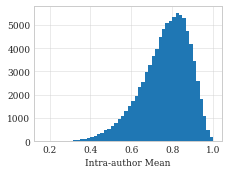

In [24]:

fig = plt.figure(figsize=(HALF_COL_WIDTH, HEIGHT))

plt.hist(intra_probs_mean, bins=50)

plt.xlabel('Intra-author Mean')
plt.grid(True, alpha=0.5)
plt.tight_layout()

plt.show()

In [26]:
intra_probs_mean.mean()

0.7638792619247831

Old Results
===

In [24]:
# Chunk size = 40, limitted data, capped
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_limitted_data_capped.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.955096
Z Score diff 0.889
Abs mean diff AUC 0.946
Abs mean diff / pooled std AUC 0.934
Unchunked AUC: 0.9423524145434861
Unchunked + Inter-Intra diff: 0.9629789980207135
Unchunked * Inter-Intra diff: 0.9581669035522099


In [37]:
# Chunk size = 20, limitted data, capped
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_limitted_data_capped.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.955382
Z Score diff 0.917
Abs mean diff AUC 0.959
Abs mean diff / pooled std AUC 0.957
Unchunked AUC: 0.942729604240274
Unchunked + Inter-Intra diff: 0.9639108756685669
Unchunked * Inter-Intra diff: 0.95797603728281


In [19]:
# Chunk size = 20, limitted data
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_limitted_data.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.95497
Z Score diff 0.915
Abs mean diff AUC 0.958
Abs mean diff / pooled std AUC 0.958
Unchunked AUC: 0.9573538393709256
Unchunked + Inter-Intra diff: 0.9695662155322642
Unchunked * Inter-Intra diff: 0.9627138744323662


In [65]:
# Chunk size = 20
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.955982
Z Score diff 0.913
Abs mean diff AUC 0.957
Abs mean diff / pooled std AUC 0.96
Unchunked AUC: 0.982199906419629
Unchunked + Inter-Intra diff: 0.9832004953892274
Unchunked * Inter-Intra diff: 0.9839968998348154


In [16]:
# Chunk size = 40
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.963309
Z Score diff 0.894
Abs mean diff AUC 0.951
Abs mean diff / pooled std AUC 0.943
Unchunked AUC: 0.9815251547168675
Unchunked + Inter-Intra diff: 0.9820966792834319
Unchunked * Inter-Intra diff: 0.9828861335654445


In [79]:
# Chunk size = 20, capped
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_capped.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.957077
Z Score diff 0.919
Abs mean diff AUC 0.959
Abs mean diff / pooled std AUC 0.96
Unchunked AUC: 0.9618395659331852
Unchunked + Inter-Intra diff: 0.9711554558838846
Unchunked * Inter-Intra diff: 0.9697168293110738


In [92]:
# Chunk size = 40, capped
fpr, tpr, thresh = roc_curve(labels, inter_probs_mean)
roc_auc = auc(fpr, tpr)
print('Inter prob mean AUC:', round(roc_auc, 6))

pp = np.abs(inter_probs_mean - intra_probs_mean)/np.sqrt(inter_probs_std**2/n_ab + intra_probs_std**2/(n_a+n_b))
pp[np.isnan(pp)] = 0.5
fpr, tpr, thresh = roc_curve(labels, pp)
roc_auc = 1 - auc(fpr, tpr)
print('Z Score diff', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - np.abs(inter_probs_mean - intra_probs_mean)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, (1 - 2 * np.abs(inter_probs_mean - intra_probs_mean)/(pooled_std)))
roc_auc = auc(fpr, tpr)
print('Abs mean diff / pooled std AUC', round(roc_auc, 3))

fpr, tpr, thresh = roc_curve(labels, probs_nc)
roc_auc = auc(fpr, tpr)
print('Unchunked AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(labels, 0.5 * (probs_nc + (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked + Inter-Intra diff:', roc_auc)


fpr, tpr, thresh = roc_curve(labels, (probs_nc * (1 - np.abs(inter_probs_mean - intra_probs_mean))))
roc_auc = auc(fpr, tpr)
print('Unchunked * Inter-Intra diff:', roc_auc)

with open(RESULTS_PATH + 'results_' + str(chunk_sz) + '_capped.p', 'wb') as f:
    pickle.dump((
        inter_probs_mean,
        intraA_probs_mean,
        intraB_probs_mean,
        inter_probs_std,
        intraA_probs_std,
        intraB_probs_std,
        labels,
        pred_lengths,
        probs_nc
    ), f)

Inter prob mean AUC: 0.959678
Z Score diff 0.89
Abs mean diff AUC 0.946
Abs mean diff / pooled std AUC 0.943
Unchunked AUC: 0.9619547907887318
Unchunked + Inter-Intra diff: 0.9710210289068322
Unchunked * Inter-Intra diff: 0.9701185492675227


In [155]:
mask = np.random.rand(len(probs_nc)) < .3

plt_x =  (1 - np.abs(inter_probs_mean - intra_probs_mean))
plt_y = probs_nc
fig = go.Figure()
fig.add_trace(go.Scatter(
    y=plt_y[np.logical_and(mask, labels == True)],
    x=plt_x[np.logical_and(mask, labels == True)],
    mode='markers',
    marker=dict(size=2),
    opacity=0.7
))

fig.add_trace(go.Scatter(
    y=plt_y[np.logical_and(mask, labels == False)],
    x=plt_x[np.logical_and(mask, labels == False)],
    mode='markers',
    marker=dict(size=2),
    opacity=0.7
))

In [26]:
fig = go.Figure()
plt_x = probs_nc *  (1 - np.abs(inter_probs_mean - intra_probs_mean))
fig.add_trace(go.Histogram(x=plt_x[labels==True]))
fig.add_trace(go.Histogram(x=plt_x[labels==False]))

In [14]:
probs_nc = np.array(probs_nc)
probs_c_mean = np.array(list(map(np.mean, probs_c)))
probs_c_std = np.array(list(map(np.std, probs_c)))

In [15]:
# capped
fpr, tpr, thresh = roc_curve(Y, probs_nc)
roc_auc = auc(fpr, tpr)
print('AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(Y, probs_c_mean)
roc_auc = auc(fpr, tpr)
print('AUC:', roc_auc)

AUC: 0.9621612337709259
AUC: 0.9580445374359967


In [32]:
fpr, tpr, thresh = roc_curve(Y, probs_nc)
roc_auc = auc(fpr, tpr)
print('AUC:', roc_auc)

fpr, tpr, thresh = roc_curve(Y, probs_c_mean)
roc_auc = auc(fpr, tpr)
print('AUC:', roc_auc)

AUC: 0.9817017882254456
AUC: 0.9633634832775699


In [18]:
mask = np.random.rand(len(probs_nc)) < 0.2

In [20]:
mask = np.random.rand(len(probs_nc)) < 0.2
fig = go.Figure()
fig.add_trace(go.Scatter(
    y=probs_nc[np.logical_and(mask, Y == True)],
    x=probs_c_mean[np.logical_and(mask, Y == True)],
    mode='markers',
    marker=dict(size=3),
    opacity=0.7
))

fig.add_trace(go.Scatter(
    y=probs_nc[np.logical_and(mask, Y == False)],
    x=probs_c_mean[np.logical_and(mask, Y == False)],
    mode='markers',
    marker=dict(size=3),
    opacity=0.7
))

In [22]:
FPs = np.logical_and(Y == 0, probs_c_mean > 0.5)
TPs = np.logical_and(Y == 1, probs_c_mean > 0.5)

FNs = np.logical_and(Y == 1, probs_c_mean < 0.5)
TNs = np.logical_and(Y == 0, probs_c_mean < 0.5)

In [121]:

fig = go.Figure()
fig.add_trace(go.Scatter(
    y=(Y - probs_c_mean)[FPs],
    x=pred_doc_lengths[FPs],
    mode='markers',
    marker=dict(size=3),
    opacity=0.7
))
# fig.add_trace(go.Scatter(
#     y=(Y - probs_c_mean)[np.logical_and(mask, Y == True)],
#     x=pred_doc_lengths[np.logical_and(mask, Y == True)],
#     mode='markers',
#     marker=dict(size=3),
#     opacity=0.7
# ))

In [25]:
p = probs_nc.copy()
p[np.logical_and.reduce([
    probs_c_mean > 0.3, probs_c_mean < 0.7,
    probs_nc > 0.4, probs_nc < 0.6

])] = 0.5

In [26]:
print('C@1', c_at_1(Y, p), c_at_1(Y, probs_nc))
fpr, tpr, thresh = roc_curve(Y, p)
print('AUC:', auc(fpr, tpr))

C@1 0.9434489770152199 0.9333469659015389
AUC: 0.9792180671322376


In [81]:
print('C@1', c_at_1(Y, p), c_at_1(Y, probs_nc))
fpr, tpr, thresh = roc_curve(Y, p)
print('AUC:', auc(fpr, tpr))

C@1 0.9509976568888368 0.9390624201216707
AUC: 0.9816533252504198


In [23]:

nc_thresholds = np.arange(0, 1, 0.1)
c_thresholds = np.arange(0, .5, 0.1)

c_at_1_scores = np.zeros((len(nc_thresholds), len(c_thresholds)))
f_05_scores = np.zeros((len(nc_thresholds), len(c_thresholds)))

for i in range(len(nc_thresholds)):
    for j in range(len(c_thresholds)):
        t = probs_nc.copy()
        t[np.logical_and.reduce([
            probs_c_mean > 0.5 -  nc_thresholds[i],
            probs_c_mean < 0.5 +  nc_thresholds[i],
            probs_nc > 0.5 - c_thresholds[j],
            probs_nc < 0.5 + c_thresholds[j]
        ])] = 0.5
        
        f_05_scores[i][j] = f_05_u_score(Y, t)
        c_at_1_scores[i][j] = c_at_1(Y, t)

In [99]:
c_at_1_scores.shape

(4, 10)

In [24]:
fig = go.Figure(data=go.Heatmap(x=nc_thresholds, y=c_thresholds, z=c_at_1_scores.T))
fig.show()

In [111]:
fig = go.Figure(data=go.Heatmap(y=nc_thresholds, x=c_thresholds, z=f_05_scores.T))
fig.show()